# Unit 5 - Financial Planning


In [21]:
# Initial imports
import json
import os
import requests
import pandas as pd
from dotenv import load_dotenv
import alpaca_trade_api as tradeapi
from MCForecastTools import MCSimulation

%matplotlib inline

In [5]:
# Load .env enviroment variables
load_dotenv()

True

## Part 1 - Personal Finance Planner

### Collect Crypto Prices Using the requests Library

In [14]:
# Set current amount of crypto assets (1.2 BTC and 5.3 ETH)
my_btc = 1.2
my_eth = 5.3

In [15]:
# Crypto API URLs
btc_url = "https://api.alternative.me/v2/ticker/Bitcoin/?convert=CAD"
eth_url = "https://api.alternative.me/v2/ticker/Ethereum/?convert=CAD"

In [56]:
# Fetch current BTC price
btc_response = requests.get(btc_url)
btc_price = btc_response.json()["data"]["1"]["quotes"]["USD"]["price"]

# Fetch current ETH price
eth_response = requests.get(eth_url)
eth_price = eth_response.json()["data"]["1027"]["quotes"]["USD"]["price"]

# Compute current value of my crpto
my_btc_value = btc_price * my_btc
my_eth_value = eth_price * my_eth
my_crypto_total = my_btc_value + my_eth_value

# Print current crypto wallet balance
print(f"The current value of your {my_btc} BTC at ${btc_price}/coin is ${my_btc_value:0.2f}")
print(f"The current value of your {my_eth} ETH is ${eth_price}/coin ${my_eth_value:0.2f}")
print(f"The current value of your crypto total is ${my_crypto_total:0.2f}")

The current value of your 1.2 BTC at $22876.0/coin is $27451.20
The current value of your 5.3 ETH is $650.29/coin $3446.54
The current value of your crypto total is $30897.74


### Collect Investments Data Using Alpaca: `SPY` (stocks) and `AGG` (bonds)

In [45]:
# Current amount of shares (50 SPY and 200 AGG)
my_spy = 50
my_agg = 200

In [32]:
# Set Alpaca API key and secret
alpaca_api_key = os.getenv("ALPACA_API_KEY")
alpaca_secret_key = os.getenv("ALPACA_SECRET_KEY")

# Create the Alpaca API object
alpaca = tradeapi.REST(alpaca_api_key, alpaca_secret_key, api_version="v2")

In [43]:
# Format current date as ISO format
start = pd.Timestamp("2020-12-18", tz="America/New_York").isoformat()

# Set the tickers
tickers = ["AGG", "SPY"]

# Set timeframe to '1D' for Alpaca API
timeframe = "1D"

# Get current closing prices for SPY and AGG
ticker_df = alpaca.get_barset(tickers, timeframe, start=start).df
ticker_df.index = ticker_df.index.date

# Preview DataFrame
ticker_df.head()

AGG                                      SPY                  \
              open    high     low   close   volume    open    high     low   
2020-12-18  117.97  117.97  117.76  117.81  3472883  370.97  371.15  367.02   

                              
             close    volume  
2020-12-18  369.13  89156141

In [44]:
# Pick AGG and SPY close prices
agg_close_price = ticker_df["AGG"]["close"][0]
spy_close_price = ticker_df["SPY"]["close"][0]

# Print AGG and SPY close prices
print(f"Current AGG closing price: ${agg_close_price}")
print(f"Current SPY closing price: ${spy_close_price}")

Current AGG closing price: $117.81
Current SPY closing price: $369.13


In [55]:
# Compute the current value of shares
my_spy_value = spy_close_price * my_spy
my_agg_value = agg_close_price * my_agg
my_shares_total = my_spy_value + my_agg_value

# Print current value of share
print(f"The current value of your {my_spy} SPY shares at ${spy_close_price}/share is ${my_spy_value:0.2f}")
print(f"The current value of your {my_agg} AGG shares at ${agg_close_price}/share is ${my_agg_value:0.2f}")
print(f"The current value of your shares total is ${my_shares_total:0.2f}")

The current value of your 50 SPY shares at $369.13/share is $18456.50
The current value of your 200 AGG shares at $117.81/share is $23562.00
The current value of your shares total is $42018.50


### Savings Health Analysis

In [66]:
# Set monthly household income ($12000)
monthly_income = 12000

# Create savings DataFrame
savings_data = {
    "amount": [my_crypto_total, my_shares_total]
}
df_savings = pd.DataFrame(savings_data, index=["crypto", "shares"])

# Display savings DataFrame
display(df_savings)

,amount
crypto,30897.737
shares,42018.500


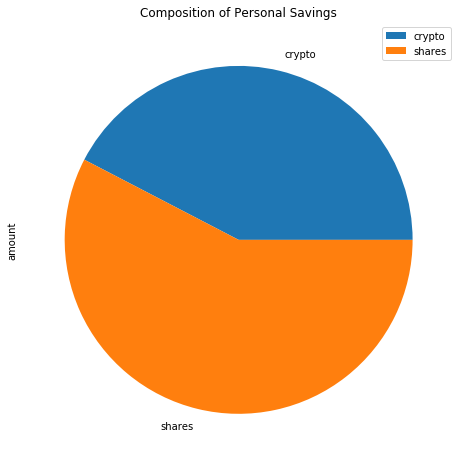

In [70]:
# Plot savings pie chart
df_savings.plot.pie(y="amount", title="Composition of Personal Savings", figsize=(8,8))

In [75]:
# Set ideal emergency fund
emergency_fund = monthly_income * 3
print(f"Emergency fund: ${emergency_fund}")

# Calculate total amount of savings
total_savings = df_savings["amount"].sum()

# Validate saving health
if total_savings > emergency_fund:
    print(f"Congratulations! You have enough savings (${total_savings:.2f}) for emergencies.")
elif total_savings == emergency_fund:
    print(f"Congratulations! You have reached your finanical goal of ${emergency_fund:.2f}")
else:
    savings_to_goal = emergency_fund - total_savings
    print(f"Keep at it! You're ${savings_to_goal:.2f} away from your financial goal.")

Emergency fund: $36000
Congratulations! You have enough savings ($72916.24) for emergencies.


## Part 2 - Retirement Planning

### Monte Carlo Simulation

In [76]:
# Set start and end dates of five years back from today.
# Sample results may vary from the solution based on the time frame chosen
start_date = pd.Timestamp('2015-12-18', tz='America/New_York').isoformat()
end_date = pd.Timestamp('2020-12-18', tz='America/New_York').isoformat()

In [77]:
# Get 5 years' worth of historical data for SPY and AGG
df_stock_data = alpaca.get_barset(tickers, timeframe, start=start_date, end=end_date).df

# Display sample data
df_stock_data.head()

AGG                                        SPY  \
                             open      high     low   close   volume    open   
time                                                                           
2015-12-18 00:00:00-05:00  108.35  108.4561  108.25  108.40  3777717  202.75   
2015-12-21 00:00:00-05:00  108.49  108.5400  108.24  108.29  2713944  201.43   
2015-12-22 00:00:00-05:00  108.27  108.2800  108.12  108.19  4323053  202.72   
2015-12-23 00:00:00-05:00  108.01  108.1900  108.00  108.18  3399409  204.71   
2015-12-24 00:00:00-05:00  107.95  108.0500  107.92  108.01  1151867  205.72   

                                                              
                             high     low   close     volume  
time                                                          
2015-12-18 00:00:00-05:00  202.93  199.96  199.96  172379995  
2015-12-21 00:00:00-05:00  201.88  200.09  201.65   80958257  
2015-12-22 00:00:00-05:00  203.85  201.55  203.51   84529093  
2015-12-23 00:00:00-05:00  206.07  204.58  206.02   79877884  
2015-12-24 00:00:00-05:00  206.33  205.42  205.57   31975061

In [78]:
# Configuring a Monte Carlo simulation to forecast 30 years cumulative returns
MC_stocks = MCSimulation(df_stock_data, weights=[0.4,0.6], num_simulation=500, num_trading_days=252*30)

In [79]:
# Printing the simulation input data
MC_stocks.portfolio_data.head()

AGG                                     \
                             open      high     low   close   volume   
time                                                                   
2015-12-18 00:00:00-05:00  108.35  108.4561  108.25  108.40  3777717   
2015-12-21 00:00:00-05:00  108.49  108.5400  108.24  108.29  2713944   
2015-12-22 00:00:00-05:00  108.27  108.2800  108.12  108.19  4323053   
2015-12-23 00:00:00-05:00  108.01  108.1900  108.00  108.18  3399409   
2015-12-24 00:00:00-05:00  107.95  108.0500  107.92  108.01  1151867   

                                           SPY                          \
                          daily_return    open    high     low   close   
time                                                                     
2015-12-18 00:00:00-05:00          NaN  202.75  202.93  199.96  199.96   
2015-12-21 00:00:00-05:00    -0.001015  201.43  201.88  200.09  201.65   
2015-12-22 00:00:00-05:00    -0.000923  202.72  203.85  201.55  203.51   
2015-12-23 00:00:00-05:00    -0.000092  204.71  206.07  204.58  206.02   
2015-12-24 00:00:00-05:00    -0.001571  205.72  206.33  205.42  205.57   

                                                   
                              volume daily_return  
time                                               
2015-12-18 00:00:00-05:00  172379995          NaN  
2015-12-21 00:00:00-05:00   80958257     0.008452  
2015-12-22 00:00:00-05:00   84529093     0.009224  
2015-12-23 00:00:00-05:00   79877884     0.012334  
2015-12-24 00:00:00-05:00   31975061    -0.002184

In [80]:
# Running a Monte Carlo simulation to forecast 30 years cumulative returns
MC_stocks.calc_cumulative_return()

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.989798,0.993750,1.000285,1.003090,1.008415,1.012571,0.993405,0.997181,1.010390,0.993575,...,0.986944,1.011284,1.000409,1.003602,1.003388,0.997086,0.986005,0.998265,0.996613,1.001252
2,0.983072,0.991004,0.999620,1.010659,1.019818,1.011149,0.990006,1.002262,1.003522,0.996660,...,0.994159,1.001739,0.982322,1.014463,0.999863,0.996792,0.980759,0.997518,1.003481,1.006410
3,0.988739,0.980563,1.001297,1.007124,1.023520,1.006181,1.000552,1.006853,1.010291,0.990003,...,0.989113,1.000561,0.977542,1.016419,0.994621,1.000785,0.984752,0.993843,0.982174,1.006028
4,0.986770,0.964174,1.003266,0.984483,1.018913,1.009145,1.006307,1.005787,0.994241,0.983925,...,0.997979,1.014385,0.970132,1.013977,1.000497,1.004929,0.978943,0.994643,0.980931,0.997817
5,0.974091,0.979985,1.007025,0.973902,1.010149,1.002516,1.006431,1.002112,0.992065,0.994670,...,0.999065,1.005128,0.973855,1.032938,1.006061,0.998991,0.979941,0.995675,0.992531,0.995618
6,0.969516,0.988312,1.006776,0.956439,1.016985,1.007880,1.004338,1.011295,1.005135,0.998521,...,1.012613,1.000164,0.981209,1.037402,1.001901,1.020893,0.986064,0.987806,0.984972,0.968129
7,0.959756,0.999474,1.001586,0.954118,1.025761,1.009347,1.011401,1.022739,1.001716,1.011130,...,1.021380,0.999766,0.982073,1.036910,1.001748,1.019183,0.985875,0.994337,0.986199,0.965529
8,0.961122,1.000711,1.001685,0.966515,1.028373,1.013050,1.012954,1.016684,1.004329,1.014659,...,1.018285,1.003833,0.986564,1.039920,1.004147,1.018207,0.990271,1.000124,0.982111,0.960954
9,0.962982,1.005784,1.001664,0.960129,1.024266,1.013032,1.016117,1.021609,1.010917,1.022336,...,1.021877,0.996780,0.987165,1.051139,1.005889,0.996921,1.004315,1.009873,0.968985,0.966094


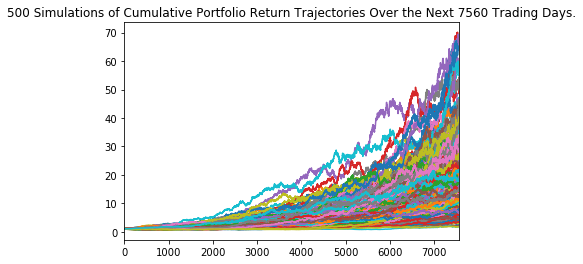

In [81]:
# Plot simulation outcomes
MC_stocks.plot_simulation()

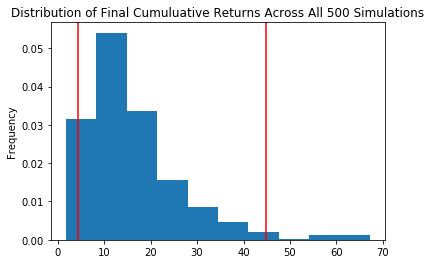

In [82]:
# Plot probability distribution and confidence intervals
MC_stocks.plot_distribution()

### Retirement Analysis

In [83]:
# Fetch summary statistics from the Monte Carlo simulation results
summary_stats = MC_stocks.summarize_cumulative_return()

# Print summary statistics
summary_stats

count           500.000000
mean             16.159774
std              10.593774
min               1.742945
25%               9.108829
50%              13.290746
75%              20.533578
max              67.255402
95% CI Lower      4.410394
95% CI Upper     44.832564
Name: 7560, dtype: float64

### Calculate the expected portfolio return at the 95% lower and upper confidence intervals based on a `$20,000` initial investment.

In [84]:
# Set initial investment
initial_investment = 20000

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $20,000
ci_lower = summary_stats["95% CI Lower"] * initial_investment
ci_upper = summary_stats["95% CI Upper"] * initial_investment

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${ci_lower} and ${ci_upper}")

There is a 95% chance that an initial investment of $20000 in the portfolio over the next 30 years will end within in the range of $88207.8703744183 and $896651.2713844497


### Calculate the expected portfolio return at the `95%` lower and upper confidence intervals based on a `50%` increase in the initial investment.

In [85]:
# Set initial investment
initial_investment = 20000 * 1.5

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $30,000
ci_lower = summary_stats["95% CI Lower"] * initial_investment
ci_upper = summary_stats["95% CI Upper"] * initial_investment

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 30 years will end within in the range of"
      f" ${ci_lower} and ${ci_upper}")

There is a 95% chance that an initial investment of $30000.0 in the portfolio over the next 30 years will end within in the range of $132311.80556162747 and $1344976.9070766745


## Optional Challenge - Early Retirement


### Five Years Retirement Option

In [24]:
# Configuring a Monte Carlo simulation to forecast 5 years cumulative returns
# YOUR CODE HERE!

In [25]:
# Running a Monte Carlo simulation to forecast 5 years cumulative returns
# YOUR CODE HERE!

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,1.002773,0.995921,0.995673,0.994602,1.005021,0.998532,1.001126,1.005124,0.994500,0.999171,...,1.002697,1.007377,0.999067,0.997822,0.998338,1.003092,0.997770,1.005395,0.999348,1.005300
2,1.004519,0.994920,0.995504,0.997885,0.999418,1.002665,0.998714,1.009062,0.992389,0.997706,...,1.004034,1.008911,0.999323,1.000654,0.999466,1.004265,0.994733,1.003748,0.996511,1.012382
3,1.003420,0.989709,0.994363,1.001670,1.004349,1.002377,1.001845,1.011481,0.991912,0.994580,...,1.002351,1.006664,1.002174,0.998934,1.003854,1.010202,0.996131,1.002018,0.999665,1.014892
4,0.999165,0.990064,0.986792,1.003455,1.007765,1.007514,0.997581,1.015886,0.986637,0.998216,...,1.002834,0.999865,1.000353,1.003079,1.003303,1.012221,0.997754,1.000544,1.001517,1.013704
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1256,1.266580,1.196174,1.233861,1.609848,1.173492,1.242440,1.329611,1.157732,1.354542,0.980124,...,1.193369,1.265576,1.176646,1.146853,1.214548,1.145207,1.193672,1.131104,1.003777,1.234636
1257,1.259830,1.201814,1.231141,1.621046,1.172662,1.239173,1.331916,1.157722,1.354061,0.980815,...,1.194320,1.269009,1.182694,1.146907,1.213701,1.143455,1.200143,1.131160,1.006530,1.234546
1258,1.265916,1.196261,1.226184,1.622075,1.174943,1.240829,1.335755,1.157986,1.350916,0.981539,...,1.203336,1.271746,1.178878,1.148263,1.213656,1.146064,1.197322,1.134041,1.005902,1.236184
1259,1.268268,1.202293,1.223321,1.623647,1.170809,1.248084,1.336792,1.162289,1.341674,0.977214,...,1.200892,1.273981,1.175435,1.145972,1.210717,1.146312,1.194024,1.132655,1.007751,1.242664


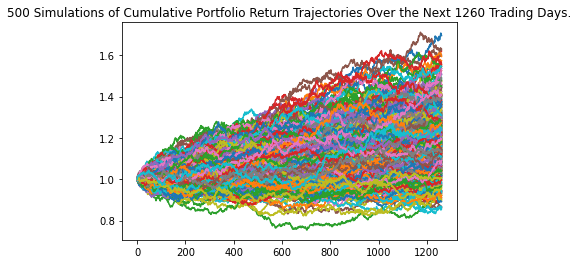

In [26]:
# Plot simulation outcomes
# YOUR CODE HERE!

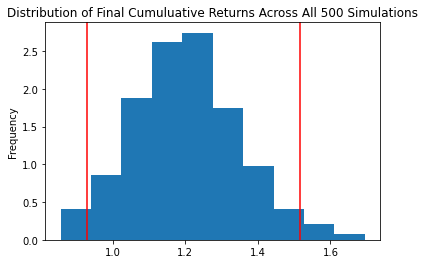

In [27]:
# Plot probability distribution and confidence intervals
# YOUR CODE HERE!

In [28]:
# Fetch summary statistics from the Monte Carlo simulation results
# YOUR CODE HERE!

# Print summary statistics
# YOUR CODE HERE!

count           500.000000
mean              1.202273
std               0.145565
min               0.856322
25%               1.100622
50%               1.197687
75%               1.292270
max               1.695081
95% CI Lower      0.928556
95% CI Upper      1.517173
Name: 1260, dtype: float64


In [29]:
# Set initial investment
# YOUR CODE HERE!

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
# YOUR CODE HERE!

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 5 years will end within in the range of"
      f" ${ci_lower_five} and ${ci_upper_five}")

There is a 95% chance that an initial investment of $60000 in the portfolio over the next 30 years will end within in the range of $55713.36 and $91030.38


### Ten Years Retirement Option

In [30]:
# Configuring a Monte Carlo simulation to forecast 10 years cumulative returns
# YOUR CODE HERE!

In [31]:
# Running a Monte Carlo simulation to forecast 10 years cumulative returns
# YOUR CODE HERE!

Running Monte Carlo simulation number 0.
Running Monte Carlo simulation number 10.
Running Monte Carlo simulation number 20.
Running Monte Carlo simulation number 30.
Running Monte Carlo simulation number 40.
Running Monte Carlo simulation number 50.
Running Monte Carlo simulation number 60.
Running Monte Carlo simulation number 70.
Running Monte Carlo simulation number 80.
Running Monte Carlo simulation number 90.
Running Monte Carlo simulation number 100.
Running Monte Carlo simulation number 110.
Running Monte Carlo simulation number 120.
Running Monte Carlo simulation number 130.
Running Monte Carlo simulation number 140.
Running Monte Carlo simulation number 150.
Running Monte Carlo simulation number 160.
Running Monte Carlo simulation number 170.
Running Monte Carlo simulation number 180.
Running Monte Carlo simulation number 190.
Running Monte Carlo simulation number 200.
Running Monte Carlo simulation number 210.
Running Monte Carlo simulation number 220.
Running Monte Carlo si

,0,1,2,3,4,5,6,7,8,9,...,490,491,492,493,494,495,496,497,498,499
0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,0.997817,0.998428,1.000816,1.000202,1.002120,0.998788,1.004226,1.004250,1.001431,1.000740,...,0.995519,1.001253,1.000492,0.994026,1.006129,1.002356,1.005233,0.999769,1.002106,1.003746
2,0.994703,0.996223,1.001987,0.998816,1.002372,0.996708,1.009074,1.006986,1.006219,0.995591,...,0.991815,1.001091,1.003774,0.989341,1.007530,1.009809,1.007273,0.999666,1.006340,0.998303
3,0.994115,0.993375,0.992622,1.001069,0.999700,1.000123,1.011610,1.009254,1.012194,0.998619,...,0.992699,1.003085,1.005997,0.991536,1.004239,1.010765,1.009501,0.999652,1.011737,0.998762
4,0.999040,0.997821,0.992272,0.999767,1.000459,1.006178,1.008906,1.009897,1.014282,0.995619,...,0.997683,1.007825,1.007858,0.991188,1.009171,1.009303,1.008223,1.003270,1.014350,1.001691
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2516,2.164254,1.246948,1.441080,1.685210,1.702114,1.474774,1.535126,1.288182,1.138653,1.500977,...,1.367442,1.357662,1.661583,1.348599,1.649220,1.782632,1.450872,1.701338,1.199957,1.171159
2517,2.169555,1.246315,1.436260,1.685058,1.697652,1.479128,1.536203,1.288485,1.144082,1.498097,...,1.366833,1.360457,1.672969,1.351751,1.646287,1.781356,1.459438,1.695322,1.197466,1.171882
2518,2.169089,1.243387,1.426446,1.685480,1.714264,1.479079,1.537777,1.289258,1.140795,1.496271,...,1.368088,1.357853,1.662915,1.354957,1.637911,1.781046,1.451367,1.695901,1.201111,1.172847
2519,2.170695,1.238881,1.419187,1.670521,1.720418,1.478161,1.544292,1.296500,1.137510,1.499085,...,1.370125,1.359697,1.664317,1.352170,1.633762,1.778638,1.443413,1.699061,1.191529,1.166331


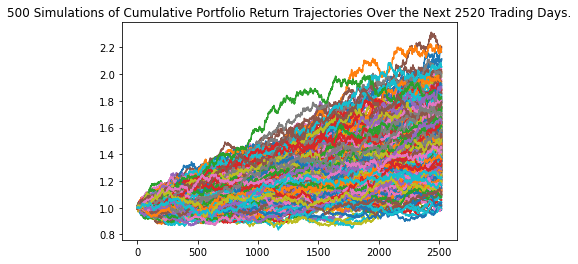

In [32]:
# Plot simulation outcomes
# YOUR CODE HERE!

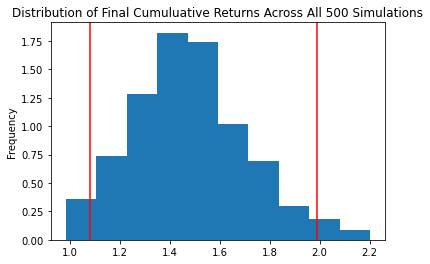

In [33]:
# Plot probability distribution and confidence intervals
# YOUR CODE HERE!

In [34]:
# Fetch summary statistics from the Monte Carlo simulation results
# YOUR CODE HERE!

# Print summary statistics
# YOUR CODE HERE!

count           500.000000
mean              1.477364
std               0.230147
min               0.984413
25%               1.319127
50%               1.468676
75%               1.613270
max               2.202006
95% CI Lower      1.083048
95% CI Upper      1.990417
Name: 2520, dtype: float64


In [35]:
# Set initial investment
# YOUR CODE HERE!

# Use the lower and upper `95%` confidence intervals to calculate the range of the possible outcomes of our $60,000
# YOUR CODE HERE!

# Print results
print(f"There is a 95% chance that an initial investment of ${initial_investment} in the portfolio"
      f" over the next 10 years will end within in the range of"
      f" ${ci_lower_ten} and ${ci_upper_ten}")

There is a 95% chance that an initial investment of $60000 in the portfolio over the next 30 years will end within in the range of $64982.9 and $119425.0
